<a href="https://colab.research.google.com/github/steevelodina/Active-Directory-Home-Lab/blob/main/Weather_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the weather data
file_path = '/content/weather_data.csv'  # Update with your actual path
weather_df = pd.read_csv(file_path)

# Convert column names to lowercase and strip spaces
weather_df.columns = weather_df.columns.str.strip().str.lower()

# Display basic info
print(weather_df.info())
print(weather_df.head())

# Convert timestamp to datetime and set as index
weather_df['utc_timestamp'] = pd.to_datetime(weather_df['utc_timestamp'])
weather_df.set_index('utc_timestamp', inplace=True)

# Check for missing values
print("Missing values per column:")
print(weather_df.isnull().sum())

# Handle missing values - forward fill for weather data
weather_df.fillna(method='ffill', inplace=True)

# Define desired column names (these might be partial)
desired_cols = ['temperature', 'wind_speed', 'radiation_direct', 'radiation_diffuse']

# Function to find the closest matching column
def find_closest_column(df, desired_col):
    for col in df.columns:
        if desired_col in col: # Check if desired_col is a substring of the actual column name
            return col
    return None  # Return None if no match is found

# Select columns using the closest match
selected_cols = [find_closest_column(weather_df, col) for col in desired_cols]

# Filter DataFrame with selected columns (excluding None values)
weather_df = weather_df[[col for col in selected_cols if col is not None]]

# Resample to hourly data if needed
if weather_df.index.inferred_freq != 'H':
    weather_df = weather_df.resample('H').mean()

# Add time-based features
weather_df['hour'] = weather_df.index.hour
weather_df['day_of_week'] = weather_df.index.dayofweek
weather_df['month'] = weather_df.index.month

# Create temperature bins
temp_col = find_closest_column(weather_df, 'temperature')  # Find the temperature column
if temp_col is not None:
    weather_df['temp_category'] = pd.cut(weather_df[temp_col],
                                       bins=[-np.inf, 0, 10, 20, 30, np.inf],
                                       labels=['freezing', 'cold', 'mild', 'warm', 'hot'])

# Display cleaned data
weather_df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 350640 entries, 0 to 350639
Data columns (total 85 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   utc_timestamp                    350640 non-null  object 
 1   at_temperature                   350640 non-null  float64
 2   at_radiation_direct_horizontal   350640 non-null  float64
 3   at_radiation_diffuse_horizontal  350640 non-null  float64
 4   be_temperature                   350640 non-null  float64
 5   be_radiation_direct_horizontal   350640 non-null  float64
 6   be_radiation_diffuse_horizontal  350640 non-null  float64
 7   bg_temperature                   350640 non-null  float64
 8   bg_radiation_direct_horizontal   350640 non-null  float64
 9   bg_radiation_diffuse_horizontal  350640 non-null  float64
 10  ch_temperature                   350640 non-null  float64
 11  ch_radiation_direct_horizontal   350640 non-null  float64
 12  ch

<ipython-input-25-c3377f32a95c>:26: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  weather_df.fillna(method='ffill', inplace=True)
<ipython-input-25-c3377f32a95c>:46: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  weather_df = weather_df.resample('H').mean()


,at_temperature,at_radiation_direct_horizontal,at_radiation_diffuse_horizontal,hour,day_of_week,month,temp_category
utc_timestamp,,,,,,,
1980-01-01 00:00:00+00:00,-3.640,0.0,0.0,0,1,1,freezing
1980-01-01 01:00:00+00:00,-3.803,0.0,0.0,1,1,1,freezing
1980-01-01 02:00:00+00:00,-3.969,0.0,0.0,2,1,1,freezing
1980-01-01 03:00:00+00:00,-4.076,0.0,0.0,3,1,1,freezing
1980-01-01 04:00:00+00:00,-4.248,0.0,0.0,4,1,1,freezing



Basic Weather Statistics:
       at_temperature  at_radiation_direct_horizontal  \
count   350640.000000                   350640.000000   
mean         7.778066                       93.706084   
std          9.067683                      175.561727   
min        -25.301000                        0.000000   
25%          0.582000                        0.000000   
50%          7.673000                        0.468550   
75%         14.744000                       98.262000   
max         33.745000                      890.054100   

       at_radiation_diffuse_horizontal           hour    day_of_week  \
count                    350640.000000  350640.000000  350640.000000   
mean                         66.977420      11.500000       2.999863   
std                          90.385764       6.922196       2.000003   
min                           0.000000       0.000000       0.000000   
25%                           0.000000       5.750000       1.000000   
50%                        

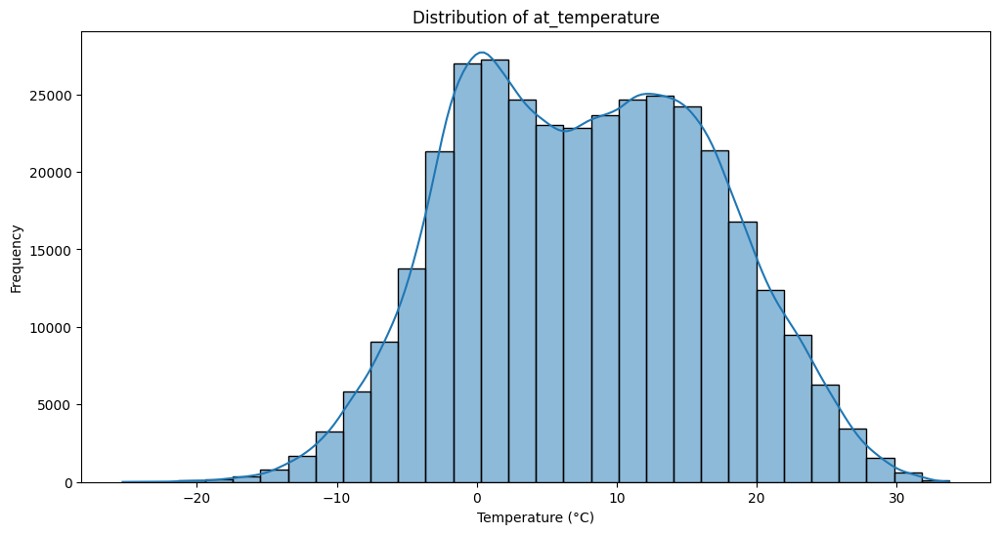

<ipython-input-27-7778da06c25b>:62: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(x='hour', y='energy_consumption', data=weather_df, ci=None)


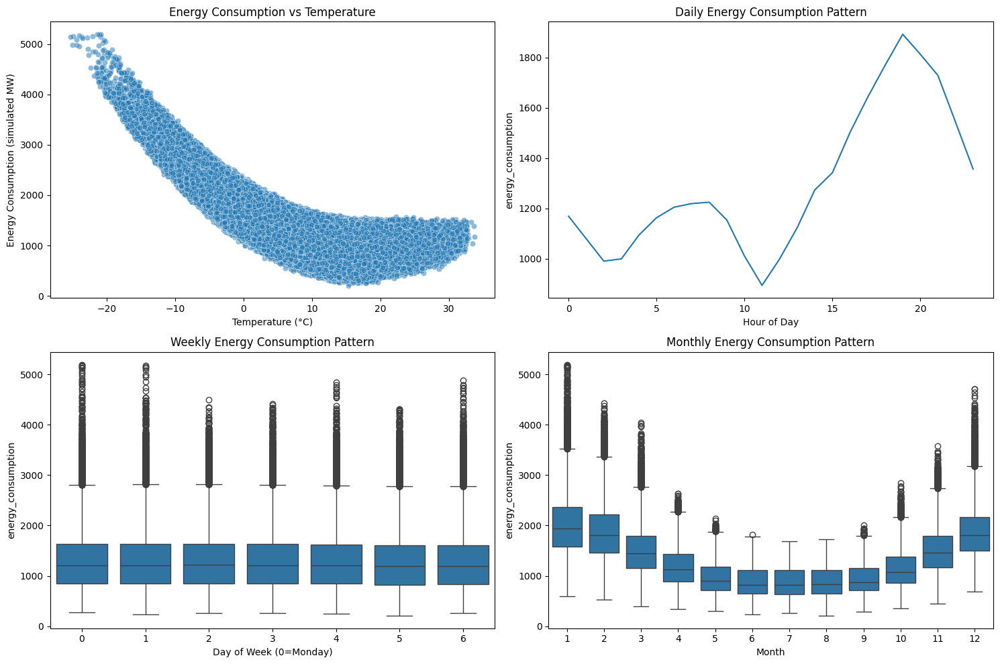


Basic Weather Statistics:
       at_temperature  at_radiation_direct_horizontal  \
count   350640.000000                   350640.000000   
mean         7.778066                       93.706084   
std          9.067683                      175.561727   
min        -25.301000                        0.000000   
25%          0.582000                        0.000000   
50%          7.673000                        0.468550   
75%         14.744000                       98.262000   
max         33.745000                      890.054100   

       at_radiation_diffuse_horizontal           hour    day_of_week  \
count                    350640.000000  350640.000000  350640.000000   
mean                         66.977420      11.500000       2.999863   
std                          90.385764       6.922196       2.000003   
min                           0.000000       0.000000       0.000000   
25%                           0.000000       5.750000       1.000000   
50%                        

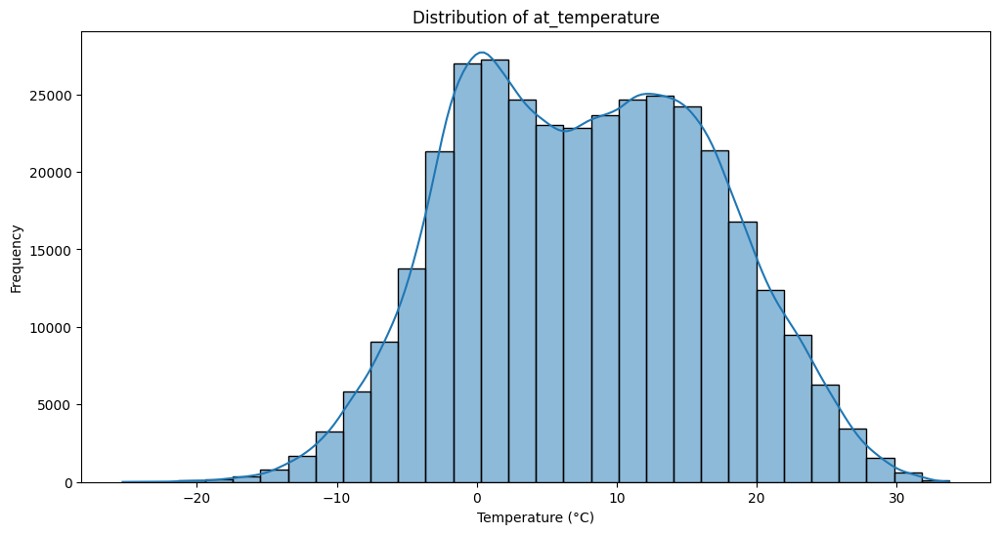

<ipython-input-27-7778da06c25b>:147: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(x='hour', y='energy_consumption', data=weather_df, ci=None)


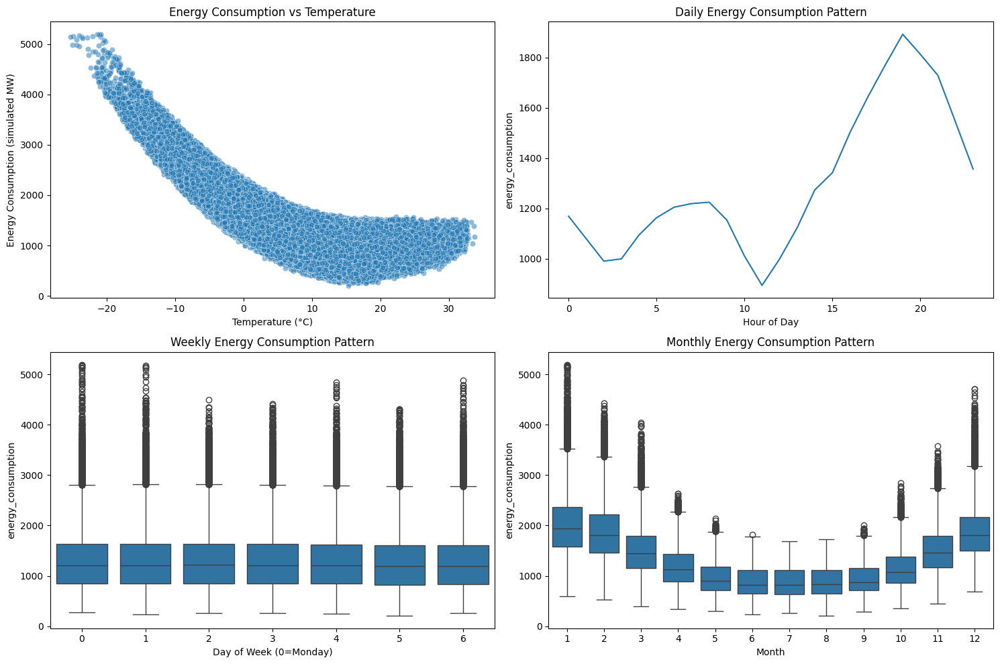

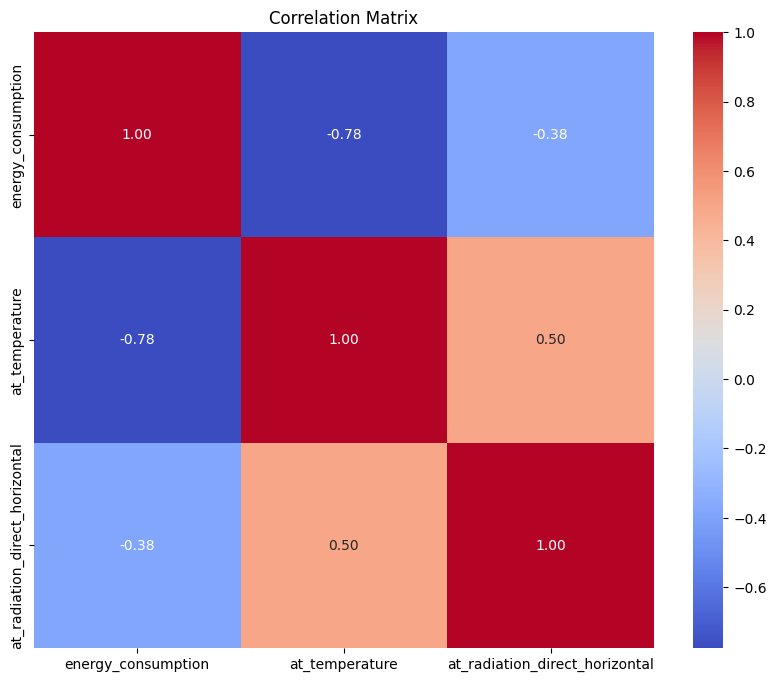

In [27]:
# 1. Weather Pattern Analysis
print("\nBasic Weather Statistics:")
print(weather_df.describe())

# Plot temperature distribution
if temp_col is not None:
    plt.figure(figsize=(12, 6))
    sns.histplot(weather_df[temp_col], bins=30, kde=True)
    plt.title(f'Distribution of {temp_col}')
    plt.xlabel('Temperature (°C)')
    plt.ylabel('Frequency')
    plt.show()

# 2. Simulate Energy Consumption (since we don't have real energy data)
np.random.seed(42)

# Base consumption pattern (daily profile)
base_consumption = np.array([
    0.6, 0.5, 0.4, 0.4, 0.5, 0.6,  # 00:00-05:00
    0.7, 0.8, 0.9, 0.9, 0.8, 0.7,  # 06:00-11:00
    0.8, 0.9, 1.0, 1.0, 1.1, 1.2,  # 12:00-17:00
    1.3, 1.4, 1.3, 1.2, 1.0, 0.8    # 18:00-23:00
])

# Create consumption based on time of day and temperature
weather_df['base_consumption'] = base_consumption[weather_df['hour']]

# Temperature effect (U-shaped relationship - more energy used at extremes)
if temp_col is not None:
    weather_df['temp_effect'] = 0.5 * (weather_df[temp_col] - 18)**2 / 100

# Weekend effect
weather_df['weekend_effect'] = weather_df['day_of_week'].isin([5,6]) * 0.1

# Solar radiation effect (if available)
rad_col = find_closest_column(weather_df, 'radiation')
if rad_col is not None:
    weather_df['solar_effect'] = -weather_df[rad_col] * 0.001  # Negative correlation

# Combine effects to create simulated consumption
weather_df['energy_consumption'] = (
    weather_df['base_consumption'] * 1000 +  # Base load
    (weather_df['temp_effect'] * 500 if 'temp_effect' in weather_df else 0) +
    weather_df['weekend_effect'] * -200 +   # Weekend reduction
    (weather_df['solar_effect'] * 300 if 'solar_effect' in weather_df else 0) +
    np.random.normal(0, 50, len(weather_df))  # Random noise
)

# 3. Visualize Relationships
plt.figure(figsize=(15, 10))

# Temperature vs Energy Consumption
if temp_col is not None:
    plt.subplot(2, 2, 1)
    sns.scatterplot(x=temp_col, y='energy_consumption', data=weather_df, alpha=0.5)
    plt.title('Energy Consumption vs Temperature')
    plt.xlabel('Temperature (°C)')
    plt.ylabel('Energy Consumption (simulated MW)')

# Hourly patterns
plt.subplot(2, 2, 2)
sns.lineplot(x='hour', y='energy_consumption', data=weather_df, ci=None)
plt.title('Daily Energy Consumption Pattern')
plt.xlabel('Hour of Day')

# Weekly patterns
plt.subplot(2, 2, 3)
sns.boxplot(x='day_of_week', y='energy_consumption', data=weather_df)
plt.title('Weekly Energy Consumption Pattern')
plt.xlabel('Day of Week (0=Monday)')

# Monthly patterns
plt.subplot(2, 2, 4)
sns.boxplot(x='month', y='energy_consumption', data=weather_df)
plt.title('Monthly Energy Consumption Pattern')
plt.xlabel('Month')

plt.tight_layout()
plt.show()

# 4. Correlation Analysis
corr_cols = ['energy_consumption']
if temp_col is not None: corr_cols.append(temp_col)
if 'wind_speed' in weather_df: corr_cols.append('wind_speed')
if rad_col is not None: corr_cols.append(rad_col)
# 1. Weather Pattern Analysis
print("\nBasic Weather Statistics:")
print(weather_df.describe())

# Plot temperature distribution
if temp_col is not None:
    plt.figure(figsize=(12, 6))
    sns.histplot(weather_df[temp_col], bins=30, kde=True)
    plt.title(f'Distribution of {temp_col}')
    plt.xlabel('Temperature (°C)')
    plt.ylabel('Frequency')
    plt.show()

# 2. Simulate Energy Consumption (since we don't have real energy data)
np.random.seed(42)

# Base consumption pattern (daily profile)
base_consumption = np.array([
    0.6, 0.5, 0.4, 0.4, 0.5, 0.6,  # 00:00-05:00
    0.7, 0.8, 0.9, 0.9, 0.8, 0.7,  # 06:00-11:00
    0.8, 0.9, 1.0, 1.0, 1.1, 1.2,  # 12:00-17:00
    1.3, 1.4, 1.3, 1.2, 1.0, 0.8    # 18:00-23:00
])

# Create consumption based on time of day and temperature
weather_df['base_consumption'] = base_consumption[weather_df['hour']]

# Temperature effect (U-shaped relationship - more energy used at extremes)
if temp_col is not None:
    weather_df['temp_effect'] = 0.5 * (weather_df[temp_col] - 18)**2 / 100

# Weekend effect
weather_df['weekend_effect'] = weather_df['day_of_week'].isin([5,6]) * 0.1

# Solar radiation effect (if available)
rad_col = find_closest_column(weather_df, 'radiation')
if rad_col is not None:
    weather_df['solar_effect'] = -weather_df[rad_col] * 0.001  # Negative correlation

# Combine effects to create simulated consumption
weather_df['energy_consumption'] = (
    weather_df['base_consumption'] * 1000 +  # Base load
    (weather_df['temp_effect'] * 500 if 'temp_effect' in weather_df else 0) +
    weather_df['weekend_effect'] * -200 +   # Weekend reduction
    (weather_df['solar_effect'] * 300 if 'solar_effect' in weather_df else 0) +
    np.random.normal(0, 50, len(weather_df))  # Random noise
)

# 3. Visualize Relationships
plt.figure(figsize=(15, 10))

# Temperature vs Energy Consumption
if temp_col is not None:
    plt.subplot(2, 2, 1)
    sns.scatterplot(x=temp_col, y='energy_consumption', data=weather_df, alpha=0.5)
    plt.title('Energy Consumption vs Temperature')
    plt.xlabel('Temperature (°C)')
    plt.ylabel('Energy Consumption (simulated MW)')

# Hourly patterns
plt.subplot(2, 2, 2)
sns.lineplot(x='hour', y='energy_consumption', data=weather_df, ci=None)
plt.title('Daily Energy Consumption Pattern')
plt.xlabel('Hour of Day')

# Weekly patterns
plt.subplot(2, 2, 3)
sns.boxplot(x='day_of_week', y='energy_consumption', data=weather_df)
plt.title('Weekly Energy Consumption Pattern')
plt.xlabel('Day of Week (0=Monday)')

# Monthly patterns
plt.subplot(2, 2, 4)
sns.boxplot(x='month', y='energy_consumption', data=weather_df)
plt.title('Monthly Energy Consumption Pattern')
plt.xlabel('Month')

plt.tight_layout()
plt.show()

# 4. Correlation Analysis
corr_cols = ['energy_consumption']
if temp_col is not None: corr_cols.append(temp_col)
if 'wind_speed' in weather_df: corr_cols.append('wind_speed')
if rad_col is not None: corr_cols.append(rad_col)

correlation_matrix = weather_df[corr_cols].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

<ipython-input-28-9a0d9a3f9f99>:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_analysis = weather_df.groupby(temp_bins)['energy_consumption'].mean()


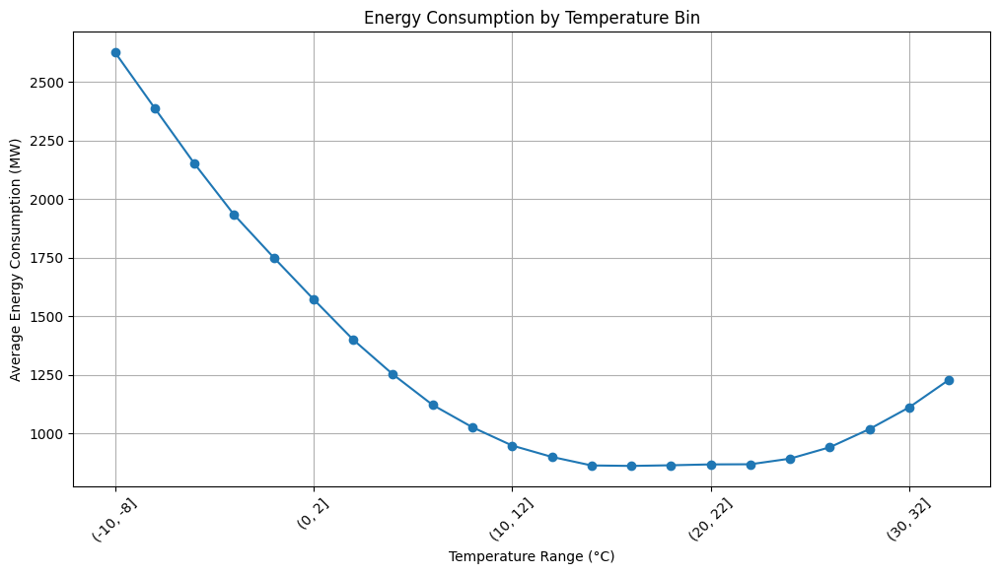

In [28]:
# Advanced temperature-energy relationship visualization
if temp_col is not None:
    plt.figure(figsize=(12, 6))

    # Bin temperature data and calculate mean consumption
    temp_bins = pd.cut(weather_df[temp_col], bins=np.arange(-10, 40, 2))
    temp_analysis = weather_df.groupby(temp_bins)['energy_consumption'].mean()

    # Plot
    temp_analysis.plot(kind='line', marker='o')
    plt.title('Energy Consumption by Temperature Bin')
    plt.xlabel('Temperature Range (°C)')
    plt.ylabel('Average Energy Consumption (MW)')
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.show()

<Figure size 1200x800 with 0 Axes>

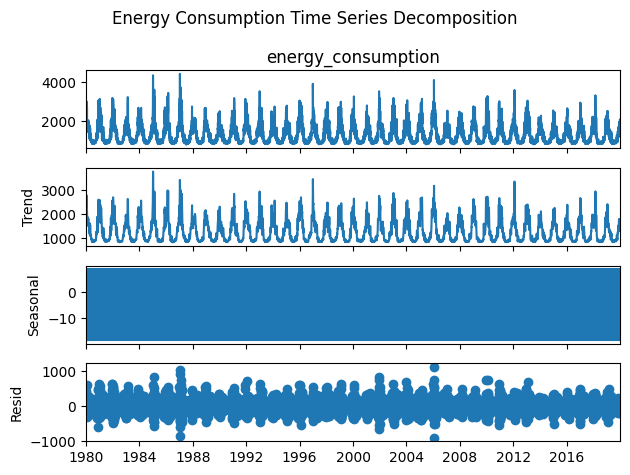

In [29]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Resample to daily data for clearer patterns
daily_energy = weather_df['energy_consumption'].resample('D').mean()

# Decompose time series
decomposition = seasonal_decompose(daily_energy, model='additive', period=7)  # Weekly seasonality

# Plot decomposition
plt.figure(figsize=(12, 8))
decomposition.plot()
plt.suptitle('Energy Consumption Time Series Decomposition')
plt.tight_layout()
plt.show()

Model Performance:
R² Score: 0.99
MAE: 43.56 MW


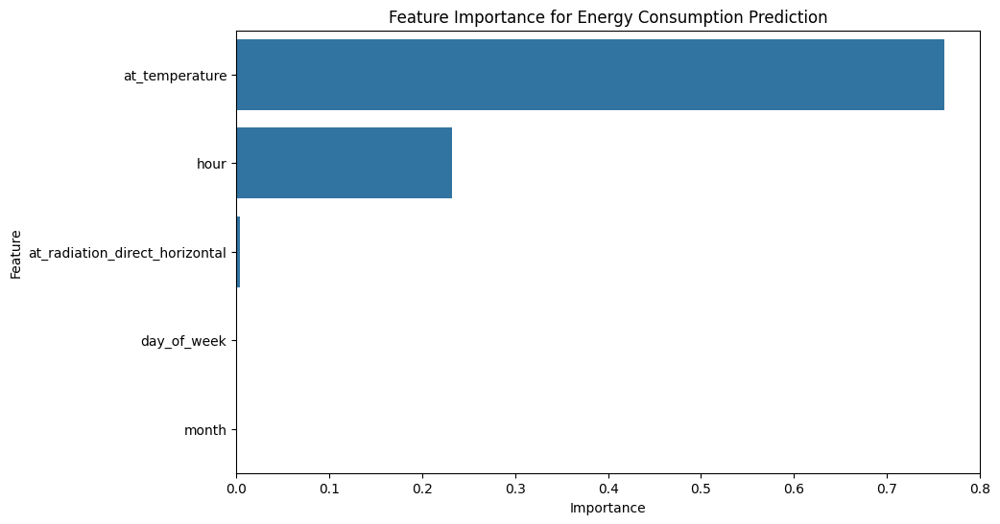

In [32]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score

# Prepare features
features = ['hour', 'day_of_week', 'month']
if temp_col is not None: features.append(temp_col)
if 'wind_speed' in weather_df: features.append('wind_speed')
if rad_col is not None: features.append(rad_col)

X = weather_df[features]
y = weather_df['energy_consumption']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train Random Forest model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Evaluate
y_pred = rf_model.predict(X_test)
print(f"Model Performance:")
print(f"R² Score: {r2_score(y_test, y_pred):.2f}")
print(f"MAE: {mean_absolute_error(y_test, y_pred):.2f} MW")

# Feature importance
importance = pd.DataFrame({
    'Feature': features,
    'Importance': rf_model.feature_importances_
}).sort_values('Importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance)
plt.title('Feature Importance for Energy Consumption Prediction')
plt.show()

In [33]:
import plotly.express as px

if temp_col is not None:
    # Interactive scatter plot
    fig = px.scatter(weather_df.reset_index(),
                    x=temp_col,
                    y='energy_consumption',
                    color='hour',
                    hover_data=['month', 'day_of_week'],
                    title='Energy Consumption vs Temperature by Hour of Day')
    fig.show()

    # Interactive time series
    fig = px.line(weather_df.reset_index(),
                 x='utc_timestamp',
                 y='energy_consumption',
                 title='Energy Consumption Over Time')
    fig.show()

In [34]:
# Save processed data with simulated consumption
weather_df.to_csv('/content/weather_energy_analysis_complete.csv')

# Save all figures
import os
os.makedirs('/content/figures', exist_ok=True)

for i in plt.get_fignums():
    plt.figure(i)
    plt.savefig(f'/content/figures/figure_{i}.png', bbox_inches='tight')

print("Analysis complete! Results saved to:")
print("- /content/weather_energy_analysis_complete.csv")
print("- /content/figures/")

Analysis complete! Results saved to:
- /content/weather_energy_analysis_complete.csv
- /content/figures/


In [35]:
# Identify peak demand hours
peak_hours = weather_df.groupby('hour')['energy_consumption'].mean().nlargest(5)

print("\nTop 5 Peak Demand Hours:")
print(peak_hours)

# Analyze weather conditions during peak vs off-peak
weather_df['is_peak'] = weather_df['hour'].isin(peak_hours.index)
peak_analysis = weather_df.groupby('is_peak')[features].mean()

print("\nAverage Conditions During Peak vs Off-Peak Hours:")
print(peak_analysis.T)


Top 5 Peak Demand Hours:
hour
19    1892.119634
20    1812.564402
18    1769.139706
21    1728.625380
17    1640.897356
Name: energy_consumption, dtype: float64

Average Conditions During Peak vs Off-Peak Hours:
is_peak                              False      True 
hour                              9.526316  19.000000
day_of_week                       2.999863   2.999863
month                             6.522930   6.522930
at_temperature                    8.049437   6.746857
at_radiation_direct_horizontal  117.997550   1.398514
